**ORTAK KISIM**

Kütüphaneler indirildi.

In [1]:
import pandas as pd
import numpy as np

Veri okundu.   

In [2]:
df=pd.read_excel("announcementData.xlsx") # "announcementData.xlsx" kısmı verilerin bulunduğu excel dosyasının adıdır.
df.head()

,Turkish,English
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,Village Teaching Skills Were Experienced on th...
1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n...","National Internship Program Dear Students,\nUn..."
2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...,Nanoparticle Integration and Usage Challenges ...
3,Hekimler İçin Almanca Hasta İletişimi ve Medik...,German Patient Communication and Medical Germa...
4,Elektronik İhale Genel Hükümler Eğitimi Değerl...,Electronic Tender General Provisions Training ...


----------------------------------------------

**Türkçe veriler**    
Türkçe cümleler ayrı bir DataFrame'e aktarıldı.

In [3]:
turkishSet=pd.DataFrame(df['Turkish'])
turkishSet.head()

,Turkish
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...
1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n..."
2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...
3,Hekimler İçin Almanca Hasta İletişimi ve Medik...
4,Elektronik İhale Genel Hükümler Eğitimi Değerl...


**SentiTurkNet dosyası**    
Bu dosyada Türkçede bulunan çoğu kelimenin duygu skoru var.       
Bag of words yöntemini kullanacağım için bu gerekli.

In [4]:
df2=pd.read_excel("sentiTurk.xlsx")
df2.head()

,synonyms,Turkish Gloss,Polarity Label,POS tag,neg value,obj value,pos value,Eng Synonyms,English Gloss,SWNpos,SWNneg
0,ayva reçeli,Meyveleri şekerle kaynatarak hazırlanan tatlı,o,n,0.06,0.872,0.068,jam#1,preserve of crushed fruit,0.0,0.0
1,gül reçeli,Meyveleri şekerle kaynatarak hazırlanan tatlı,o,n,0.06,0.872,0.068,jam#1,preserve of crushed fruit,0.0,0.0
2,incir reçeli,Meyveleri şekerle kaynatarak hazırlanan tatlı,o,n,0.06,0.872,0.068,jam#1,preserve of crushed fruit,0.0,0.0
3,iştah,Yemek yeme isteği.,o,n,0.06,0.872,0.068,NaN,NaN,NaN,NaN
4,iştahlı,"İştahı olan, boğazlı",p,a,0.06,0.462,0.478,NaN,NaN,NaN,NaN


Gereksiz kısımları attım ve işime yarayacak kısımları dfScore isimli DataFrame'e aktardım.

In [5]:
dfScore=pd.DataFrame([df2["synonyms"],df2["Polarity Label"],df2["neg value"],df2["obj value"],df2["pos value"]])
dfScore=dfScore.T
dfScore.head()

,synonyms,Polarity Label,neg value,obj value,pos value
0,ayva reçeli,o,0.06,0.872,0.068
1,gül reçeli,o,0.06,0.872,0.068
2,incir reçeli,o,0.06,0.872,0.068
3,iştah,o,0.06,0.872,0.068
4,iştahlı,p,0.06,0.462,0.478


Türkçe harfler küçük harfe dönüştürüldü.

In [6]:
turkishSet["lowerSentence"] = turkishSet.apply(lambda x: x.astype(str).str.lower())
turkishSet.head()

,Turkish,lowerSentence
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,köy öğretmenlik becerileri yerinde deneyimlend...
1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n...","ulusal staj programı değerli öğrencilerimiz,\n..."
2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...,termal akışkan sistemlerde nanoparçacık entegr...
3,Hekimler İçin Almanca Hasta İletişimi ve Medik...,hekimler i̇çin almanca hasta i̇letişimi ve med...
4,Elektronik İhale Genel Hükümler Eğitimi Değerl...,elektronik i̇hale genel hükümler eğitimi değer...


Cümlelerde bulunan gereksiz kelimeleri buraya ekledim ki bunlara göre cümlelerden kelimeleri atalım. Ekleme işlemini manuel olarak yaptım.

In [7]:
stopWords=['acaba','altmış','altı','ama','bana','bazı','belki','ben','benden','beni','benim','ben','bin','bir','biri','birkaç',
'birkez','birşey','birşeyi','biz','bizden','bizi','bizim','bu','buna','bunda','bundan','bunu','bunun','da','daha',
'dahi','de','defa','diye','doksan''dokuz','dört','elli','hem','hep','hepsi','her','hiç','iki','ile','ise','için',
'katrilyon','kez','ki','kim','kimden','kime','kimi','kırk''milyar','milyon','mu','mü','mı','nasıl','ne','neden',
'nerde','nerede','nereye','niye','niçin','on','ona','ondan','onlar','onlardan','onları''onların','onu','otuz','sanki','sekiz',
'seksen','sen','senden','seni','senin','siz','sizden','sizi','sizin','trilyon','tüm','ve''veya','ya','yani','yedi','yetmiş',
'yirmi','yüz','çok','çünkü','üç','şey','şeyden','şeyi','şeyler','şu','şuna','şunda','bundan','bunu','düzce','a1','a2','a3',
'dr.','prof.','(yds)','(avt)','(marka)','1001','ocak','şubat','mart','nisan','mayıs','haziran','temmuz','ağustos','eylül',
'ekim','kasım','aralık','1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22',
'23','24','25','26','27','28','22’de','ve','i.','ii','ii.','iii.','iii','III.','xxv.','iv.','vii.','viii.','v.',',','.',':',';',
'-','_','?','=','#','+','(',')','1.','1.lik','1.0','2.','2.0','3.','3.0','4.','4th','4.0','5.','5.0','6.','6.0','7.','7.0','8.',
'8.0','9.','9.0','10.','11.','12.','13.','14.','15.','16.','17.','18.','19.','20.','21.','22.','23.','24.','25.','26.','100.',
'2020','2020’nin','2021','2021’nin','2022','2022’nin','2023','2023’ün','2021-2022','2022-2023','2019','i','&']

In [8]:
turkishSet['cleanSentences']=turkishSet['lowerSentence'].apply(lambda x: ' '.join([word for word in x.split()
                                                                                   if word not in (stopWords)]))

In [9]:
turkishSet["cleanSentences"].iloc[500:550] #Hala gereksiz kelime varmı diye kontrol ettik.

500    hakkari yöresi geleneksel el sanatları fotoğra...
501    ergen günleri sempozyumu değerli mensuplarımız...
502    bartın üniversitesi uluslararası fen bilimleri...
503    almanca seviye sertifika programı tenis eğitim...
504    first international workshop atmospheric chemi...
505    lisansüstü tez araştırma bursu destek programı...
506    i̇ngilizce akademik yazma-i̇ngilizce akademik ...
507    akdeniz hemşirelik dergisi/akd hemşirelik d de...
508    yeni dünya düzenine uygun etkileşimli öğretim ...
509    uluslararası turkcess eğitim sosyal bilimler k...
510    “temas” başlıklı sergi sanatseverleri bekliyor...
511    yeşil sentez teknikleri eğitimi değerli mensup...
512    uluslararası rahva teknik sosyal araştırmalar ...
513    van yüzüncü yıl üniversitesi uluslararası sağl...
514    i̇şler bellek sergisi değerli mensuplarımız, v...
515    psikiyatri birimlerinde hemşirelik hizmetleri ...
516    atletizm aday hakem kursu değerli mensuplarımı...
517    üretilen nesneler sanatı

**Kelimelerin köklerini bulmak için zemberek kullanılacak.**   

In [10]:
from typing import List
from jpype import JClass, JString, getDefaultJVMPath, shutdownJVM, startJVM, java

Zemberek modülü java için yapıldığı için bulunduğu dosya konumu startJVM içine yazılarak çağrılır.   
Ayrıca burada sanal makineyi başlattım.

In [11]:
ZEMBEREK_PATH = "./zemberek-full.jar"
startJVM(getDefaultJVMPath(), '-ea', '-Djava.class.path=%s' % (ZEMBEREK_PATH))

Değişkenlere eklerden kurulmak için kullanılan metotlar atıldı.

In [12]:
TurkishMorphology = JClass('zemberek.morphology.TurkishMorphology')
morphology = TurkishMorphology.createWithDefaults()

In [13]:
for num in range(len(turkishSet.cleanSentences)):
    analysis: java.util.ArrayList = (morphology.analyzeAndDisambiguate(turkishSet.cleanSentences[num]).bestAnalysis())
    pos: List[str] = []
    for i, analysis in enumerate(analysis, start=1):
        f'\nAnalysis {i}: {analysis}', f'\nPrimary POS {i}: {analysis.getPos()}' f'\nPrimary POS (Short Form) {i}: {analysis.getPos().shortForm}'
        pos.append(
            f'{str(analysis.getLemmas()[0])}'
        )
    turkishSet.xs(num)['cleanSentences'] = " ".join(pos)

In [14]:
turkishSet['cleanSentences']=turkishSet['cleanSentences'].str.replace("UNK"," ")

Kelimelerin eklerden ayrılmış halleri;

In [15]:
turkishSet[["lowerSentence","cleanSentences"]]

,lowerSentence,cleanSentences
0,köy öğretmenlik becerileri yerinde deneyimlend...,köy öğretmen beceri yer deneyimle kocaeli sağl...
1,"ulusal staj programı değerli öğrencilerimiz,\n...","ulusal staj program değer öğrenci , cumhurbaşk..."
2,termal akışkan sistemlerde nanoparçacık entegr...,termal akışkan sistem entegrasyon kullanım zor
3,hekimler i̇çin almanca hasta i̇letişimi ve med...,hekim almanca hast medikal al kurs değer m...
4,elektronik i̇hale genel hükümler eğitimi değer...,"elektronik genel hüküm eğitim değer mensup ,..."
...,...,...
1493,uluslararası beşeri bilimler kongresi (interna...,uluslararası beşeri bilim kongre ( internation...
1494,mühendislik alanında tübi̇tak 1001 proje yazma...,mühendis alan proje yazma eğitim değer mensu...
1495,covid-19 gölgesinde okula başlayan çocuklara n...,gölge okul başla çocuk davran ? üniversite e...
1496,uzaktan eğitimi i̇yileştirme çalışmaları ünive...,uzak eğitim çalış üniversite çalıştay masa y...


In [16]:
turkishSet.cleanSentences

0       köy öğretmen beceri yer deneyimle kocaeli sağl...
1       ulusal staj program değer öğrenci , cumhurbaşk...
2        termal akışkan sistem   entegrasyon kullanım zor
3       hekim   almanca hast   medikal al kurs değer m...
4       elektronik   genel hüküm eğitim değer mensup ,...
                              ...                        
1493    uluslararası beşeri bilim kongre ( internation...
1494    mühendis alan   proje yazma eğitim değer mensu...
1495      gölge okul başla çocuk davran ? üniversite e...
1496    uzak eğitim   çalış üniversite çalıştay masa y...
1497    kocaeli sağlık teknoloji üniversite rektör rek...
Name: cleanSentences, Length: 1498, dtype: object

Sanal makineyi kapattım.

In [17]:
shutdownJVM()

Cümlelerin içindeki boşluk sayılarını düzenledim.    
Birazdan kelimeleri diziye atacağım zaman split metodu sıkıntı çıkarmayacak.

In [18]:
def throwSpace(sentence):
    #Cümlenin başındaki ve sonundaki boşlukları siler.
    sentence=sentence.strip()
    #Split ile kelimeleri diziye attım.
    words = sentence.split()
    #En son tek boşluk içerecek şekilde birleştirdim.
    sentence = " ".join(words)
    
    #---- ' , ' Bazı ifadelerin kalkmadığını gördüğümden manuel değiştirdim. turkishSet.iloc[] komutu ile kontrol ederek yaptım.
    sentence=sentence.replace(" , "," ")
    sentence=sentence.replace(" ( ) "," ")
    sentence=sentence.replace(". "," ")
    sentence=sentence.replace(" - "," ")
    sentence=sentence.replace(" : "," ")
    sentence=sentence.replace(" + "," ")
    sentence=sentence.replace('" ','')
    sentence=sentence.replace(" ; "," ")
    sentence=sentence.replace(" ( "," ")
    sentence=sentence.replace("- "," ")
    sentence=sentence.replace(", "," ")
    sentence=sentence.replace(" ) "," ")
    sentence=sentence.replace(" -19 "," ")
    sentence=sentence.replace("22 "," ")
    sentence=sentence.replace(" / "," ")
    sentence=sentence.replace(": "," ")
    sentence=sentence.replace(" ! "," ")
    sentence=sentence.replace(" … "," ")
    sentence=sentence.replace("( "," ")
    #----
    
    return sentence

turkishSet["cleanSentences"] = turkishSet["cleanSentences"].apply(throwSpace)
turkishSet.head()

,Turkish,lowerSentence,cleanSentences
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,köy öğretmenlik becerileri yerinde deneyimlend...,köy öğretmen beceri yer deneyimle kocaeli sağl...
1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n...","ulusal staj programı değerli öğrencilerimiz,\n...",ulusal staj program değer öğrenci cumhurbaşkan...
2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...,termal akışkan sistemlerde nanoparçacık entegr...,termal akışkan sistem entegrasyon kullanım zor
3,Hekimler İçin Almanca Hasta İletişimi ve Medik...,hekimler i̇çin almanca hasta i̇letişimi ve med...,hekim almanca hast medikal al kurs değer mensu...
4,Elektronik İhale Genel Hükümler Eğitimi Değerl...,elektronik i̇hale genel hükümler eğitimi değer...,elektronik genel hüküm eğitim değer mensup ted...


Cümleleri kelimelerine ayırdım çünkü bag of words yöntemiyle duyguları analiz edeceğim.

In [19]:
turkishSet['tokenSentences']=turkishSet['cleanSentences'].str.split(' ')
turkishSet['tokenSentences'].head(5)

0    [köy, öğretmen, beceri, yer, deneyimle, kocael...
1    [ulusal, staj, program, değer, öğrenci, cumhur...
2    [termal, akışkan, sistem, entegrasyon, kullanı...
3    [hekim, almanca, hast, medikal, al, kurs, değe...
4    [elektronik, genel, hüküm, eğitim, değer, mens...
Name: tokenSentences, dtype: object

In [20]:
# Veri çerçevesindeki kelime ve kelime öbeklerini bir sözlükte sakladım birazdan bunu kullanacağım.
sentiment_data_neg = dict(zip(dfScore["synonyms"],dfScore["neg value"]))
sentiment_data_obj = dict(zip(dfScore["synonyms"],dfScore["obj value"]))
sentiment_data_pos = dict(zip(dfScore["synonyms"],dfScore["pos value"]))

Cümlelerin teker teker pozitif, negatif ve nötr skorlarını toplayan fonksiyonlar.

In [21]:
#Duyguların toplanmış hali.
def analyze_sentiment_pos(words):  
    # Cümlenin pozitif duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_pos = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_pos += sentiment_data_pos.get(word, 0)
    return sentiment_score_pos

def analyze_sentiment_neg(words):  
    # Cümlenin negatif duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_neg = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_neg += sentiment_data_neg.get(word, 0)
    return sentiment_score_neg

def analyze_sentiment_obj(words):  
    # Cümlenin nötr duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_obj = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_obj += sentiment_data_obj.get(word, 0)
    return sentiment_score_obj

In [22]:
#Cümle içindeki yüzdelikleri.
def percent_pos(words):  
    # Cümlenin tüm duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_obj = 0
    sentiment_score_neg = 0
    sentiment_score_pos = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_pos += sentiment_data_pos.get(word, 0)
        sentiment_score_neg += sentiment_data_neg.get(word, 0)
        sentiment_score_obj += sentiment_data_obj.get(word, 0)
    #Duyguların toplam skora göre yüzdeliği.
    total_score=sentiment_score_obj+sentiment_score_neg+sentiment_score_pos
    #İşlem hata vermesin diye 0'dan farklı değerleri hesapladım.
    if(total_score!=0):
        percentage_pos=sentiment_score_pos*100/total_score
        return percentage_pos
    else:
        return 0 
    
def percent_neg(words):  
    # Cümlenin tüm duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_obj = 0
    sentiment_score_neg = 0
    sentiment_score_pos = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_pos += sentiment_data_pos.get(word, 0)
        sentiment_score_neg += sentiment_data_neg.get(word, 0)
        sentiment_score_obj += sentiment_data_obj.get(word, 0)
    #Duyguların toplam skora göre yüzdeliği.
    total_score=sentiment_score_obj+sentiment_score_neg+sentiment_score_pos
    #İşlem hata vermesin diye 0'dan farklı değerleri hesapladım.
    if(total_score!=0):
        percentage_neg=sentiment_score_neg*100/total_score
        return percentage_neg
    else:
        return 0
    
def percent_obj(words):  
    # Cümlenin tüm duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_obj = 0
    sentiment_score_neg = 0
    sentiment_score_pos = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_pos += sentiment_data_pos.get(word, 0)
        sentiment_score_neg += sentiment_data_neg.get(word, 0)
        sentiment_score_obj += sentiment_data_obj.get(word, 0)
    #Duyguların toplam skora göre yüzdeliği.
    total_score=sentiment_score_obj+sentiment_score_neg+sentiment_score_pos
    #İşlem hata vermesin diye 0'dan farklı değerleri hesapladım.
    if(total_score!=0):
        percentage_obj=sentiment_score_obj*100/total_score
        return percentage_obj
    else:
        return 0

In [23]:
#Cümledeki hakim duygu.
def feel_score(words):  
    # Cümlenin tüm duygu puanını hesaplamak için tanımlama yaptım.
    sentiment_score_obj = 0
    sentiment_score_neg = 0
    sentiment_score_pos = 0
    for word in words:
        # Kelimenin duygu puanını SentiTurkNet veri kümesinden aldım
        sentiment_score_pos += sentiment_data_pos.get(word, 0)
        sentiment_score_neg += sentiment_data_neg.get(word, 0)
        sentiment_score_obj += sentiment_data_obj.get(word, 0)
    #Duyguların toplam skora göre yüzdeliği.
    total_score=sentiment_score_obj+sentiment_score_neg+sentiment_score_pos
    if(total_score!=0):
        percentage_obj=sentiment_score_obj*100/total_score
        percentage_pos=sentiment_score_pos*100/total_score
        percentage_neg=sentiment_score_neg*100/total_score
    else:
        percentage_obj=100.00
        percentage_pos=percentage_neg=0.00
    
    if(percentage_obj>percentage_pos and percentage_obj>percentage_neg):
        return "Nötr"
    elif(percentage_pos>percentage_obj and percentage_pos>percentage_neg):
        return "Pozitif"
    else:
        return "Negatif"

In [24]:
turkishSet["NegatifPuan"] = turkishSet["tokenSentences"].apply(analyze_sentiment_neg)
turkishSet["PozitifPuan"] = turkishSet["tokenSentences"].apply(analyze_sentiment_pos)
turkishSet["NötrPuan"] = turkishSet["tokenSentences"].apply(analyze_sentiment_obj)
turkishSet["NegatifYüzde"] = turkishSet["tokenSentences"].apply(percent_neg)
turkishSet["PozitifYüzde"] = turkishSet["tokenSentences"].apply(percent_pos)
turkishSet["NötrYüzde"] = turkishSet["tokenSentences"].apply(percent_obj)
turkishSet["DuyguTipi"] = turkishSet["tokenSentences"].apply(feel_score)
turkishSet.head()

,Turkish,lowerSentence,cleanSentences,tokenSentences,NegatifPuan,PozitifPuan,NötrPuan,NegatifYüzde,PozitifYüzde,NötrYüzde,DuyguTipi
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,köy öğretmenlik becerileri yerinde deneyimlend...,köy öğretmen beceri yer deneyimle kocaeli sağl...,"[köy, öğretmen, beceri, yer, deneyimle, kocael...",1.46,5.933,10.607,8.111111,32.961111,58.927778,Nötr
1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n...","ulusal staj programı değerli öğrencilerimiz,\n...",ulusal staj program değer öğrenci cumhurbaşkan...,"[ulusal, staj, program, değer, öğrenci, cumhur...",1.14,3.679,15.181,5.700000,18.395000,75.905000,Nötr
2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...,termal akışkan sistemlerde nanoparçacık entegr...,termal akışkan sistem entegrasyon kullanım zor,"[termal, akışkan, sistem, entegrasyon, kullanı...",0.18,1.016,1.804,6.000000,33.866667,60.133333,Nötr
3,Hekimler İçin Almanca Hasta İletişimi ve Medik...,hekimler i̇çin almanca hasta i̇letişimi ve med...,hekim almanca hast medikal al kurs değer mensu...,"[hekim, almanca, hast, medikal, al, kurs, değe...",0.66,2.372,7.968,6.000000,21.563636,72.436364,Nötr
4,Elektronik İhale Genel Hükümler Eğitimi Değerl...,elektronik i̇hale genel hükümler eğitimi değer...,elektronik genel hüküm eğitim değer mensup ted...,"[elektronik, genel, hüküm, eğitim, değer, mens...",1.26,4.676,15.064,6.000000,22.266667,71.733333,Nötr


------------

**İNGİLİZCE KISIM**

In [25]:
englishSet=pd.DataFrame(df['English'])
englishSet.head()

,English
0,Village Teaching Skills Were Experienced on th...
1,"National Internship Program Dear Students,\nUn..."
2,Nanoparticle Integration and Usage Challenges ...
3,German Patient Communication and Medical Germa...
4,Electronic Tender General Provisions Training ...


In [26]:
englishSet["lowerSentences"]=englishSet["English"].str.lower()
englishSet["lowerSentences"].head()

0    village teaching skills were experienced on th...
1    national internship program dear students,\nun...
2    nanoparticle integration and usage challenges ...
3    german patient communication and medical germa...
4    electronic tender general provisions training ...
Name: lowerSentences, dtype: object

In [27]:
engStopWords=['i','me','my','myself','we','our','ours','ourselves','you','your','yours','yourself','yourselves','he','him','his',
'himself','she','her','hers','herself','it','its','itself','they','them','their','theirs','themselves','what','which','who',
'whom','this','that','these','those','am','is','are','was','were','be','been','being','have','has','had','having','do','does',
'did','doing','a','an','the','and','but','if','or','because','as','until','while','of','at','by','for','with','about','against',
'between','into','through','during','before','after','above','below','to','from','up','down','in','out','on','off','over',
'under','again','further','then','once','here','there','when','where','why','how','all','any','both','each','few','more','most',
'other','some','such','no','nor','not','only','own','same','so','than','too','very','s','t','can','will','just','don','should',
'now','i.','ii','ii.','iii.','iii','III.','xxv.','iv.','vii.','viii.','v.',',','.',':',';','-','_','?','=','#','+','(',')','1.',
'1.0','2.','2.0','3.','3.0','4.','4th','4.0','5.','5.0','6.','6.0','7.','7.0','8.','8.0','9.','9.0','10.','11.','12.','13.',
'14.','15.','16.','17.','18.','19.','20.','21.','22.','23.','24.','25.','26.','100.','2020','2021','2022','2023','2021-2022',
'2022-2023','2019','i','&','1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22',
'23','24','25','26','27','28','1001','düzce','a1','a2','a3']

In [28]:
englishSet['cleanSentences']=englishSet['lowerSentences'].apply(lambda x: ' '.join([word for word in x.split() if word not in (engStopWords)]))
englishSet['cleanSentences'].head()

0    village teaching skills experienced site recto...
1    national internship program dear students, coo...
2    nanoparticle integration usage challenges ther...
3    german patient communication medical german co...
4    electronic tender general provisions training ...
Name: cleanSentences, dtype: object

In [29]:
cleanSentences = pd.DataFrame(englishSet['cleanSentences'])
cleanSentences["rowId"]=cleanSentences.index+1
cleanSentences=cleanSentences[["rowId","cleanSentences"]]
cleanSentences.head()

,rowId,cleanSentences
0,1,village teaching skills experienced site recto...
1,2,"national internship program dear students, coo..."
2,3,nanoparticle integration usage challenges ther...
3,4,german patient communication medical german co...
4,5,electronic tender general provisions training ...


In [30]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to C:\Users\Batuhan
[nltk_data]     DEMİRTÜRK\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [31]:
feelSentences=pd.DataFrame()
feelSentences["rowId"]=['99999999999']
feelSentences["feelType"]='NA999NA'
feelSentences["feelScore"]=0
feelSentences

,rowId,feelType,feelScore
0,99999999999,NA999NA,0


In [32]:
sid = SentimentIntensityAnalyzer()
finalFrame = feelSentences

In [33]:
for index, row in cleanSentences.iterrows():
    scores = sid.polarity_scores(row[1])
    for key, value in scores.items():
        temp = [key,value,row[0]]
        feelSentences['rowId']=row[0]
        feelSentences['feelType']=key
        feelSentences['feelScore']=value
        finalFrame=finalFrame.append(feelSentences)

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=finalFrame.append(feelSentences)
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3230697163.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  finalFrame=f

In [34]:
cleanFinalFrame = finalFrame[finalFrame.rowId != '99999999999']
cleanFinalFrame = cleanFinalFrame.drop_duplicates()
cleanFinalFrame = finalFrame[finalFrame.feelType == 'compound']
cleanFinalFrame.head()

,rowId,feelType,feelScore
0,1,compound,0.8583
0,2,compound,0.7003
0,3,compound,0.0772
0,4,compound,0.3818
0,5,compound,0.7430


In [35]:
for i in np.arange(len(cleanFinalFrame)):
    if(cleanFinalFrame["feelScore"].iloc[i]>0.5):
        cleanFinalFrame["feelType"].iloc[i]="Pozitif"
    elif(cleanFinalFrame["feelScore"].iloc[i]<-0.5):
        cleanFinalFrame["feelType"].iloc[i]="Negatif"
    else:
        cleanFinalFrame["feelType"].iloc[i]="Nötr"
cleanFinalFrame.head()

C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3899975948.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cleanFinalFrame["feelType"].iloc[i]="Pozitif"
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3899975948.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cleanFinalFrame["feelType"].iloc[i]="Nötr"
C:\Users\Batuhan DEMİRTÜRK\AppData\Local\Temp\ipykernel_22288\3899975948.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

,rowId,feelType,feelScore
0,1,Pozitif,0.8583
0,2,Pozitif,0.7003
0,3,Nötr,0.0772
0,4,Nötr,0.3818
0,5,Pozitif,0.7430


In [36]:
cleanFinalFrame.index=np.arange(len(cleanFinalFrame))
cleanFinalFrame.head()

,rowId,feelType,feelScore
0,1,Pozitif,0.8583
1,2,Pozitif,0.7003
2,3,Nötr,0.0772
3,4,Nötr,0.3818
4,5,Pozitif,0.7430


In [37]:
englishSet["feelScore"]=cleanFinalFrame.feelScore
englishSet["feelType"]=cleanFinalFrame.feelType
englishSet.head()

,English,lowerSentences,cleanSentences,feelScore,feelType
0,Village Teaching Skills Were Experienced on th...,village teaching skills were experienced on th...,village teaching skills experienced site recto...,0.8583,Pozitif
1,"National Internship Program Dear Students,\nUn...","national internship program dear students,\nun...","national internship program dear students, coo...",0.7003,Pozitif
2,Nanoparticle Integration and Usage Challenges ...,nanoparticle integration and usage challenges ...,nanoparticle integration usage challenges ther...,0.0772,Nötr
3,German Patient Communication and Medical Germa...,german patient communication and medical germa...,german patient communication medical german co...,0.3818,Nötr
4,Electronic Tender General Provisions Training ...,electronic tender general provisions training ...,electronic tender general provisions training ...,0.7430,Pozitif


In [38]:
englishSet.iloc[:,[0,3,4]]

,English,feelScore,feelType
0,Village Teaching Skills Were Experienced on th...,0.8583,Pozitif
1,"National Internship Program Dear Students,\nUn...",0.7003,Pozitif
2,Nanoparticle Integration and Usage Challenges ...,0.0772,Nötr
3,German Patient Communication and Medical Germa...,0.3818,Nötr
4,Electronic Tender General Provisions Training ...,0.7430,Pozitif
...,...,...,...
1493,"""International Humanities Congress (Internatio...",0.3818,Nötr
1494,"""TUBITAK 1001 Project Writing Training in the ...",0.3818,Nötr
1495,"""How to Treat Children Starting School in the ...",0.9979,Pozitif
1496,"""Distance Education Improvement Studies are Di...",0.9972,Pozitif


------

**GRAFİKLER**

Gereken kütüphane import edildi.

In [39]:
import seaborn as sns

In [40]:
sns.set_theme()
sns.set(rc={"figure.dpi":600})
sns.set(rc={"figure.figsize":(6,6)})

**Türkçe Kısım**

In [41]:
turkishSet.head(1)

,Turkish,lowerSentence,cleanSentences,tokenSentences,NegatifPuan,PozitifPuan,NötrPuan,NegatifYüzde,PozitifYüzde,NötrYüzde,DuyguTipi
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,köy öğretmenlik becerileri yerinde deneyimlend...,köy öğretmen beceri yer deneyimle kocaeli sağl...,"[köy, öğretmen, beceri, yer, deneyimle, kocael...",1.46,5.933,10.607,8.111111,32.961111,58.927778,Nötr


In [42]:
turkishSetNew=pd.DataFrame(turkishSet,columns=["Turkish","NegatifPuan","PozitifPuan","NötrPuan","DuyguTipi","NegatifYüzde","PozitifYüzde","NötrYüzde"])
turkishSetNew["Index"]=turkishSetNew.index
turkishSetNew=pd.DataFrame(turkishSetNew,columns=["Index","Turkish","NegatifPuan","PozitifPuan","NötrPuan","DuyguTipi","NegatifYüzde","PozitifYüzde","NötrYüzde"])
turkishSetNew.head()

,Index,Turkish,NegatifPuan,PozitifPuan,NötrPuan,DuyguTipi,NegatifYüzde,PozitifYüzde,NötrYüzde
0,0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,1.46,5.933,10.607,Nötr,8.111111,32.961111,58.927778
1,1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n...",1.14,3.679,15.181,Nötr,5.700000,18.395000,75.905000
2,2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...,0.18,1.016,1.804,Nötr,6.000000,33.866667,60.133333
3,3,Hekimler İçin Almanca Hasta İletişimi ve Medik...,0.66,2.372,7.968,Nötr,6.000000,21.563636,72.436364
4,4,Elektronik İhale Genel Hükümler Eğitimi Değerl...,1.26,4.676,15.064,Nötr,6.000000,22.266667,71.733333


**SAÇILIM GRAFİĞİ** 

Saçılım grafiğinde yüzdelik pozitif skorlara göre cümlelerin duygu durumu.

<AxesSubplot:xlabel='Index', ylabel='NötrYüzde'>

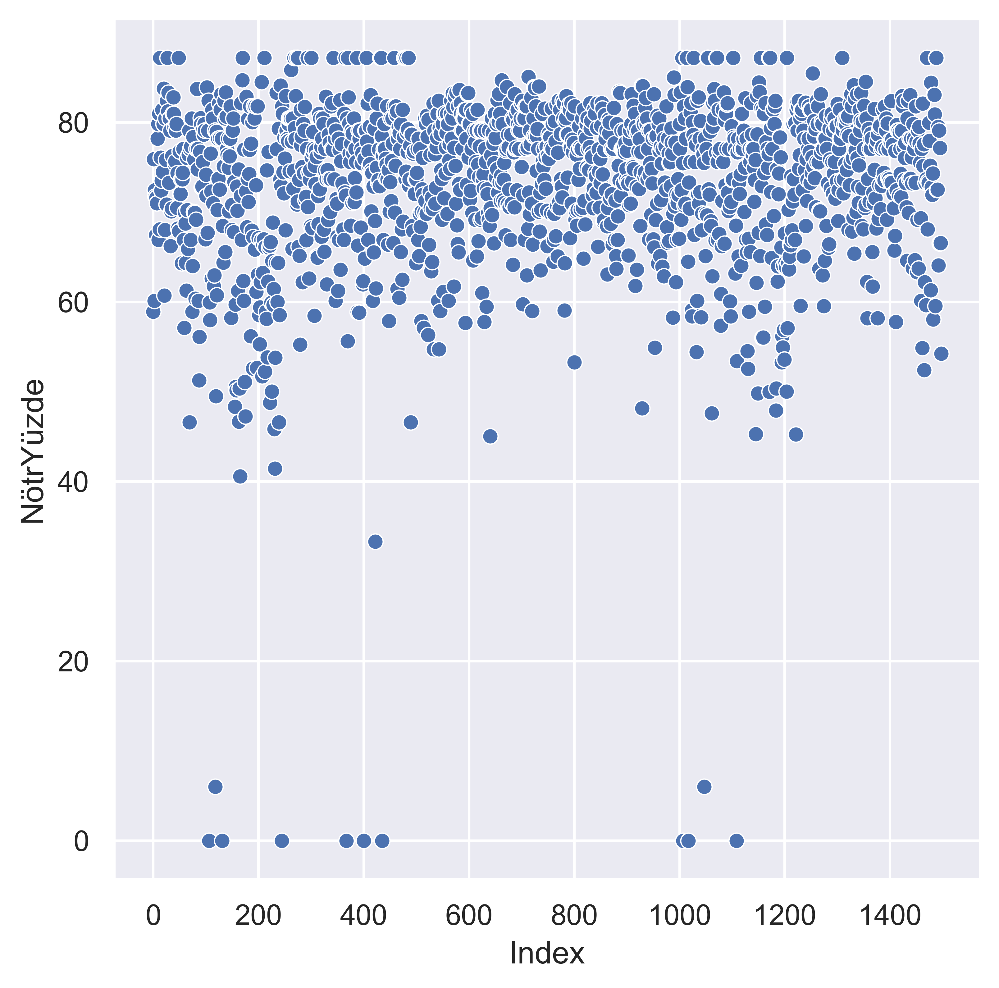

In [43]:
sns.scatterplot(x="Index",y="NötrYüzde",data=turkishSetNew)

**HİSTOGRAM GRAFİĞİ**  

Histogram grafiğinde duygu skorlarının dağılımı ve olasılık dağılım eğrisi.

<AxesSubplot:xlabel='DuyguTipi', ylabel='Count'>

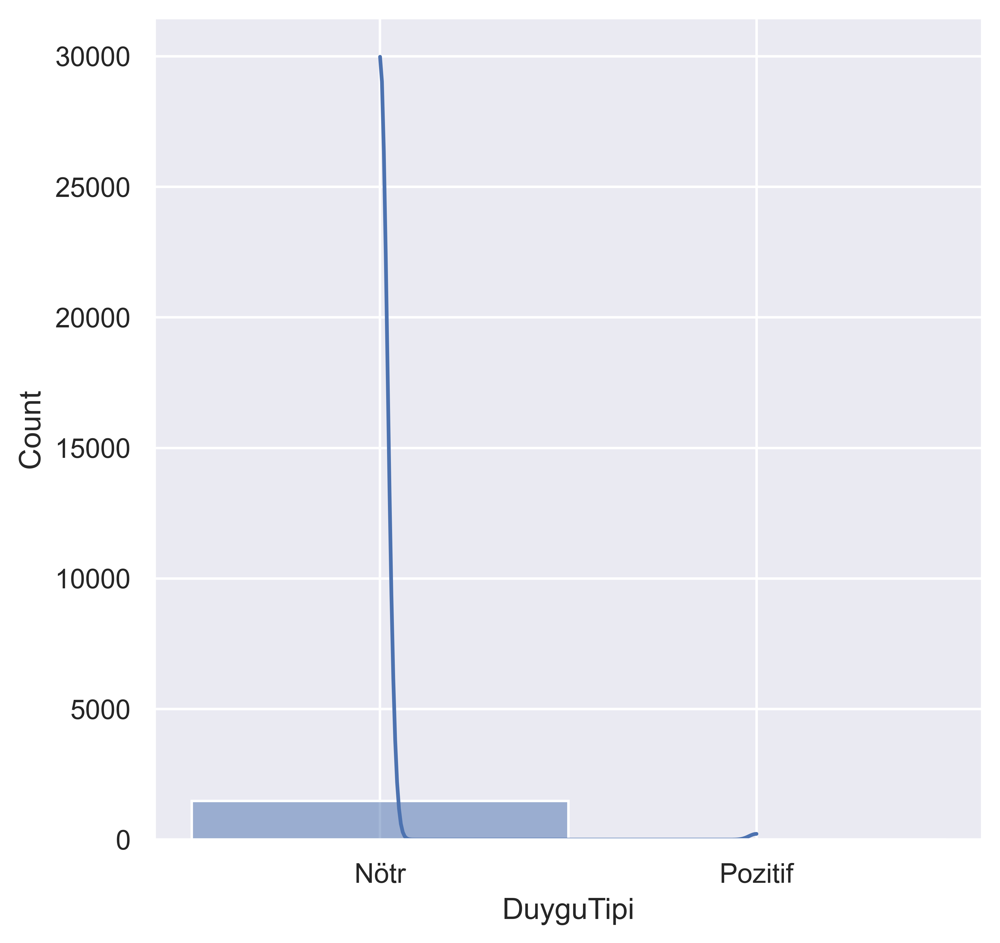

In [44]:
sns.histplot(x="DuyguTipi",data=turkishSetNew,kde=True)

Histogram grafiğine skorun cümlelere göre dağılımı ve olasılık dağılım eğrisi.

<AxesSubplot:xlabel='Index', ylabel='Count'>

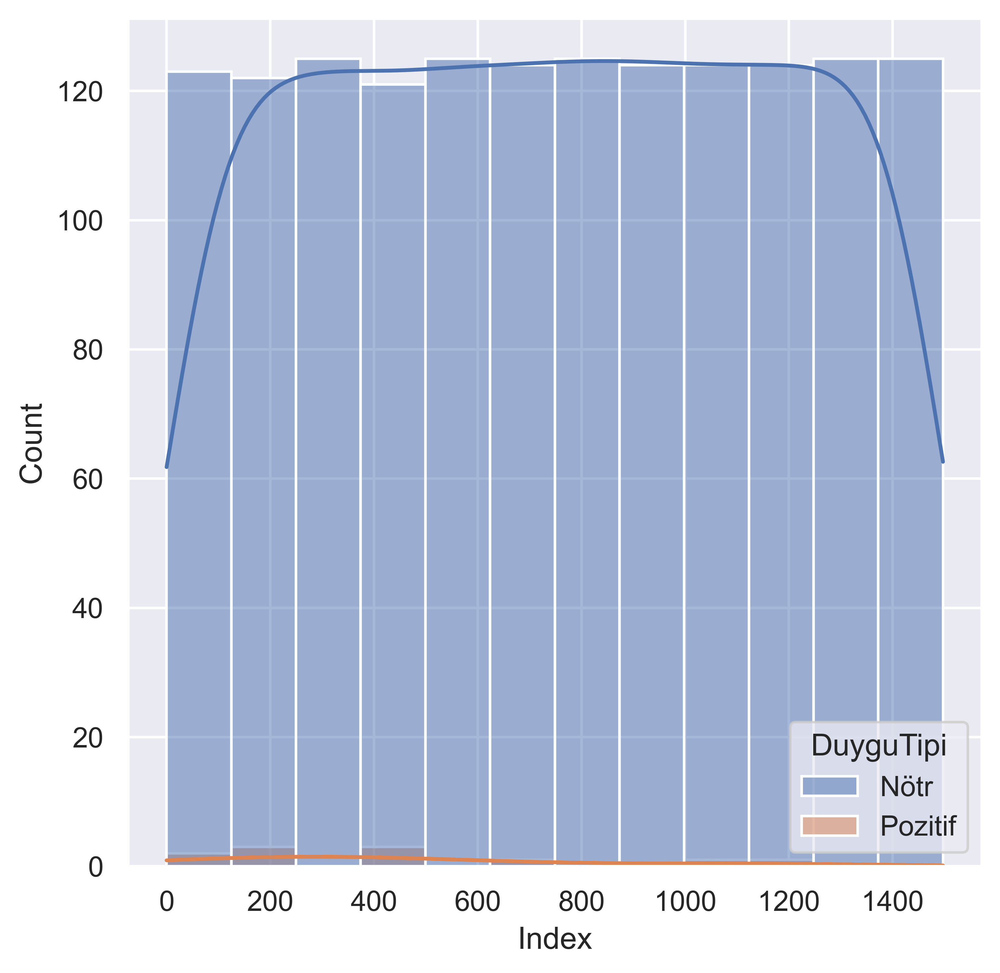

In [45]:
sns.histplot(x="Index",data=turkishSetNew,kde=True,hue="DuyguTipi")

**KUTU GRAFİĞİ**

Kutu grafiğine göre duygu tiplerinin cümlelere göre durumu.

<AxesSubplot:xlabel='DuyguTipi', ylabel='Index'>

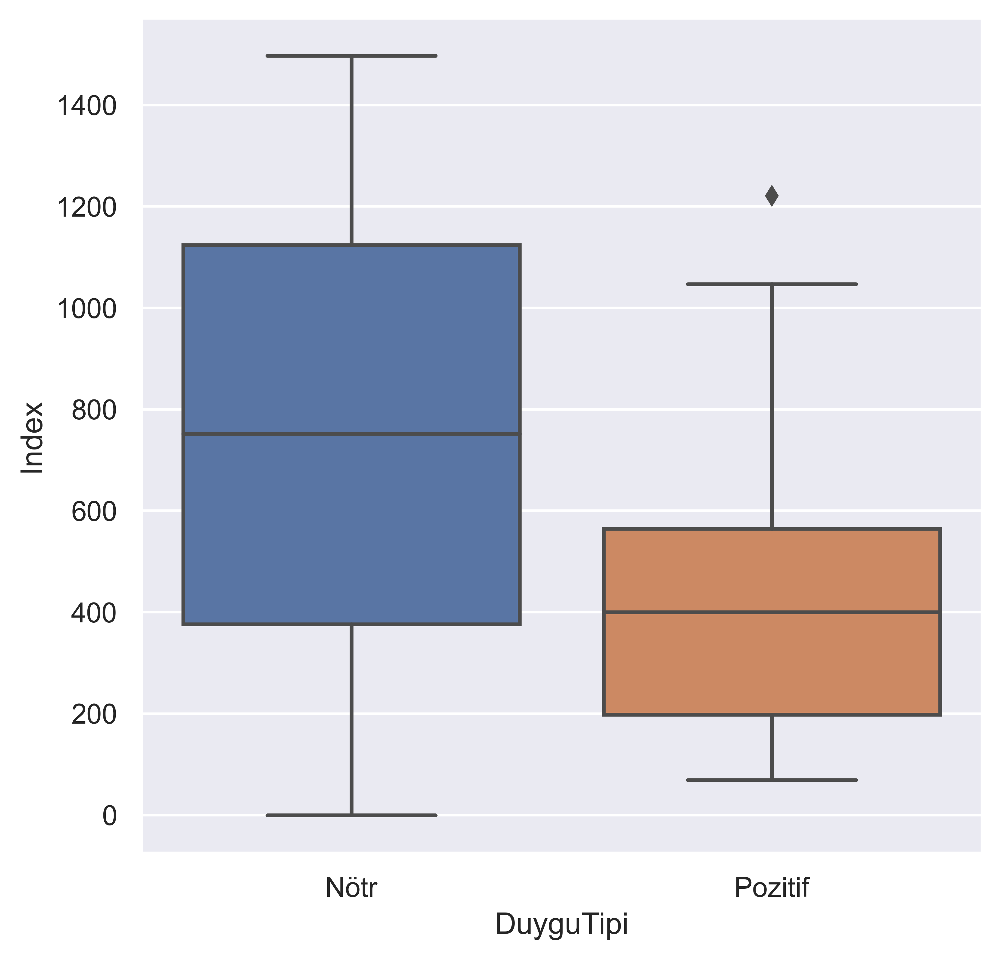

In [46]:
sns.boxplot(x="DuyguTipi",y="Index",data=turkishSetNew)

**VİOLİN GRAFİĞİ** 

Violin grafiğinde indekslere göre duygu tiplerinin dağılımı.

<AxesSubplot:xlabel='DuyguTipi', ylabel='Index'>

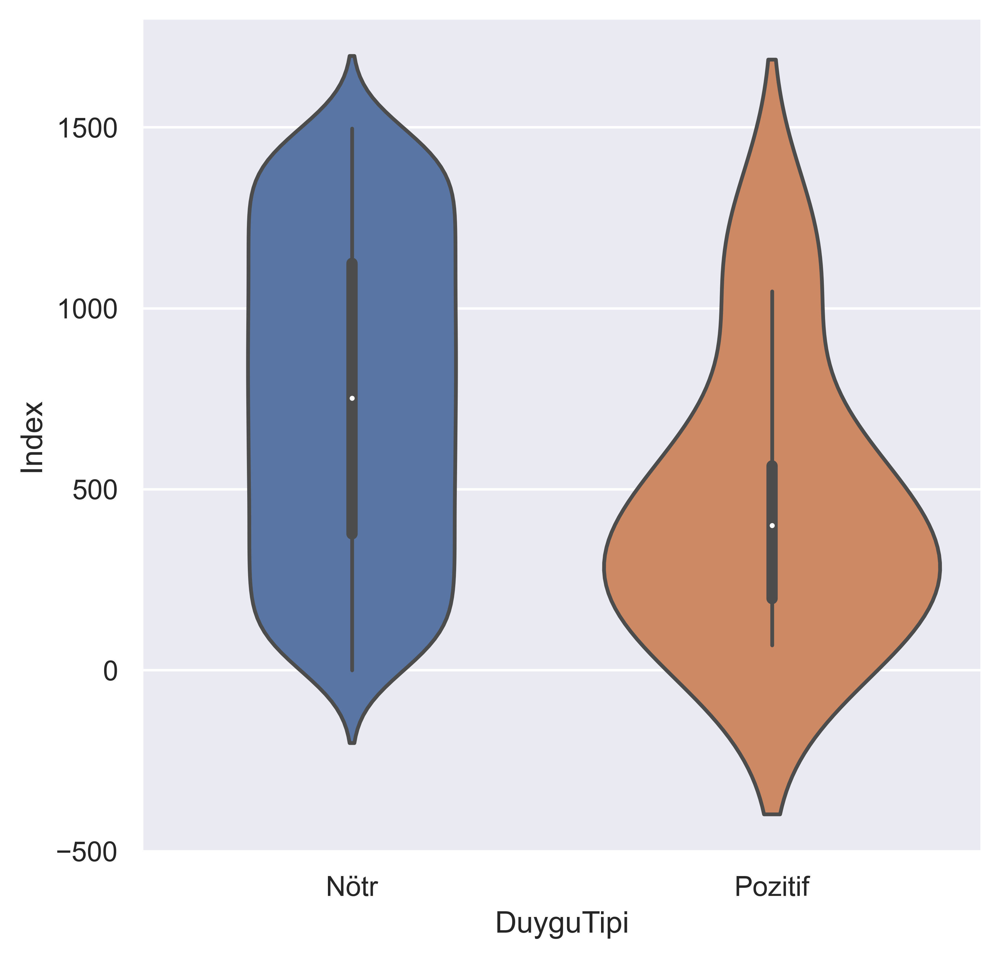

In [47]:
sns.violinplot(x="DuyguTipi",y="Index",data=turkishSetNew)

In [48]:
turkishSetNew.head(1)

,Index,Turkish,NegatifPuan,PozitifPuan,NötrPuan,DuyguTipi,NegatifYüzde,PozitifYüzde,NötrYüzde
0,0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,1.46,5.933,10.607,Nötr,8.111111,32.961111,58.927778


In [49]:
a=pd.DataFrame(turkishSetNew,columns=["Index","NegatifYüzde","PozitifYüzde","NötrYüzde","DuyguTipi"])
sns.pairplot(a,hue="DuyguTipi",height=5)

**İngilizce Kısım**

In [50]:
englishSetNew=pd.DataFrame(englishSet,columns=["English","feelScore","feelType"])
englishSetNew["Index"]=englishSetNew.index
englishSetNew.head(1)

,English,feelScore,feelType,Index
0,Village Teaching Skills Were Experienced on th...,0.8583,Pozitif,0


**SAÇILIM GRAFİĞİ** 

Saçılım grafiğinde duygu tipine göre gruplandırılan duygu skorlarının cümlelere göre dağılımları.

<AxesSubplot:xlabel='Index', ylabel='feelScore'>

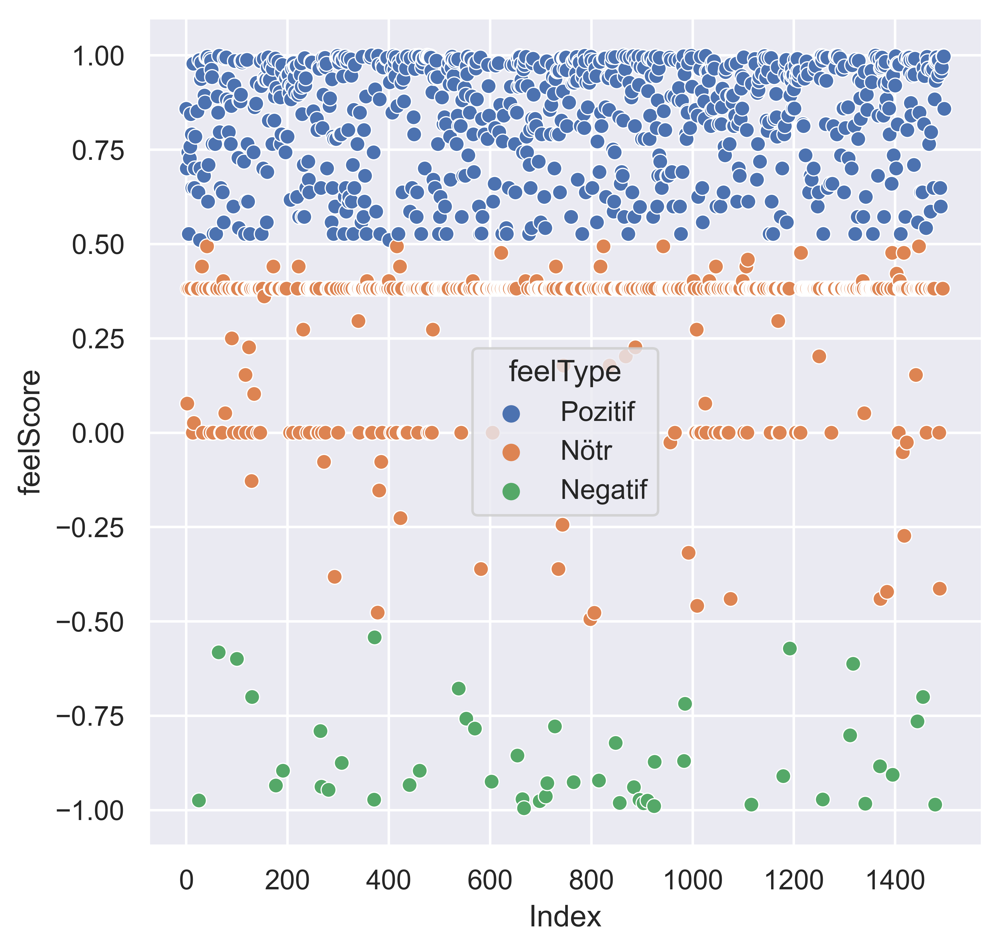

In [51]:
sns.scatterplot(x="Index",y="feelScore",data=englishSetNew,hue="feelType")

**HİSTOGRAM GRAFİĞİ**  

Histogram grafiğinde duygu tiplerine göre duygu skorlarının dağılımı.

<AxesSubplot:xlabel='feelScore', ylabel='Count'>

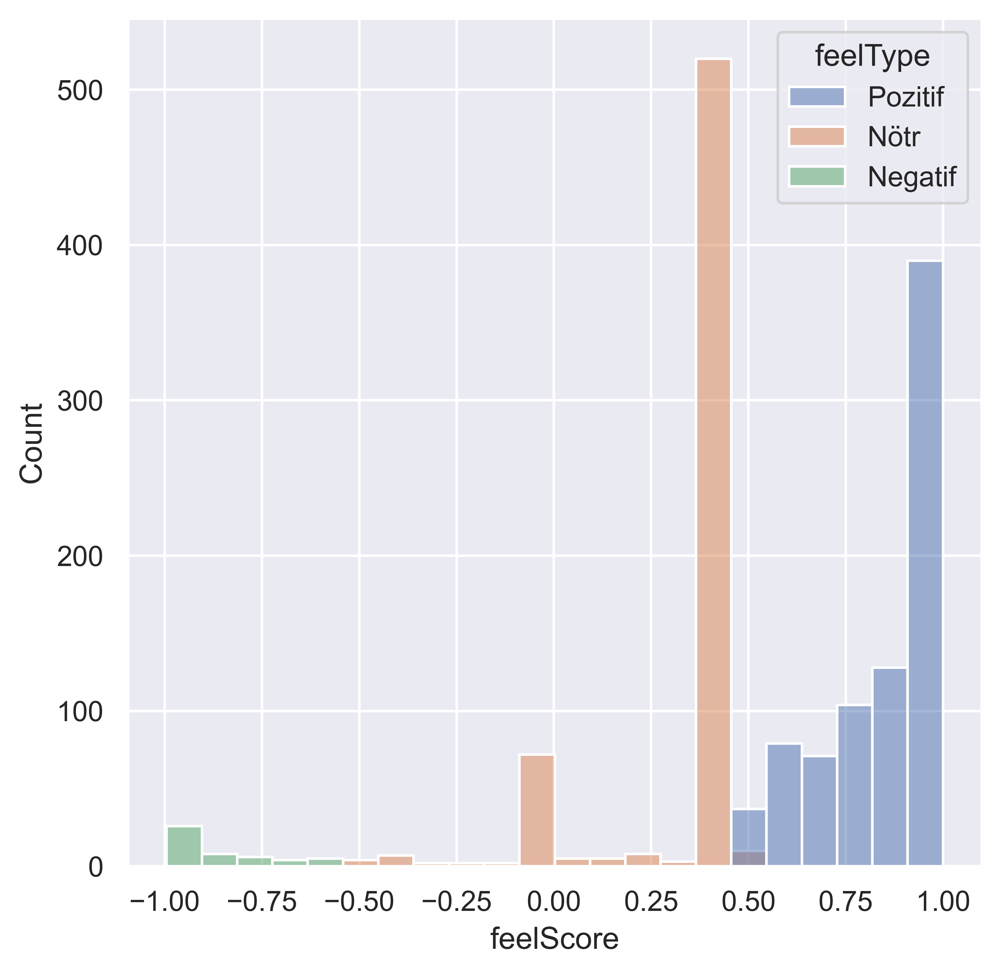

In [52]:
sns.histplot(x="feelScore",data=englishSetNew,hue="feelType")

**KUTU GRAFİĞİ**

Kutu grafiği ile duygu tipinin indexlere göre durumu.

<AxesSubplot:xlabel='feelType', ylabel='Index'>

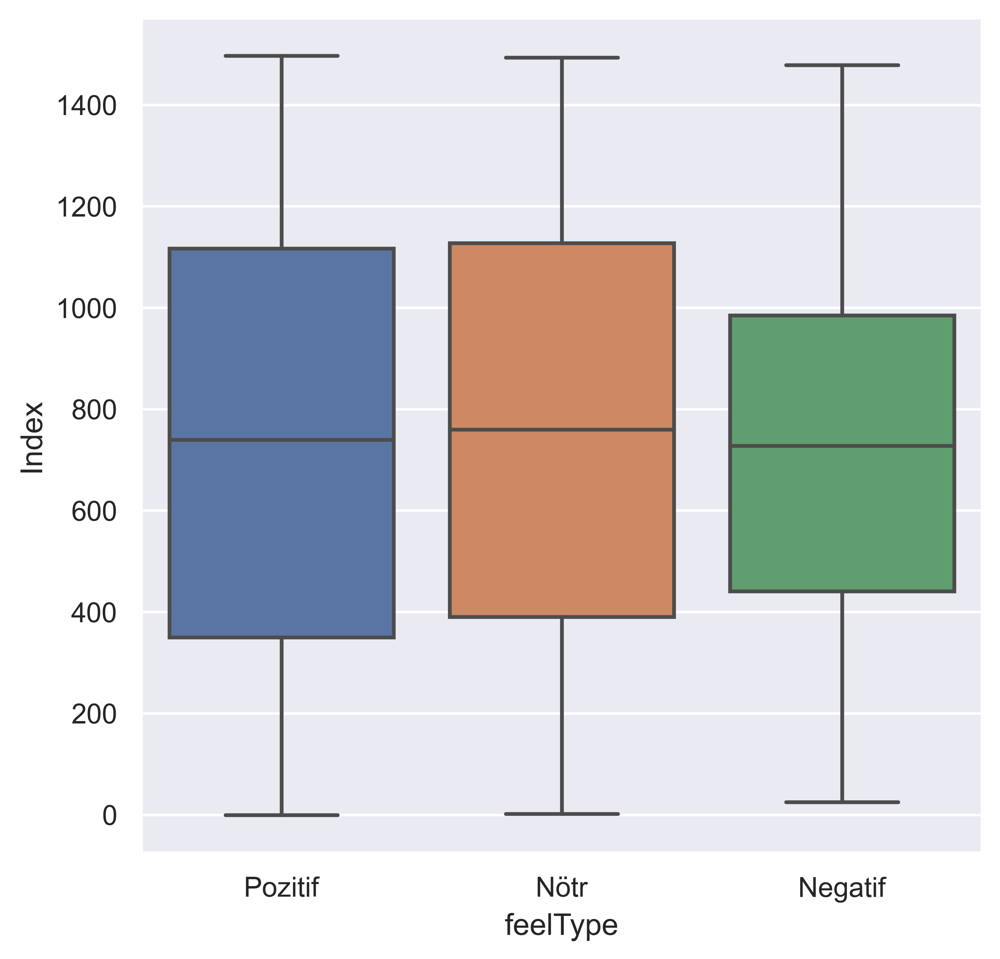

In [53]:
sns.boxplot(x="feelType",y="Index",data=englishSetNew)

**VİOLİN GRAFİĞİ** 

Violin grafiği ile duygu skorlarının cümlelere göre durumu.

<AxesSubplot:xlabel='feelType', ylabel='Index'>

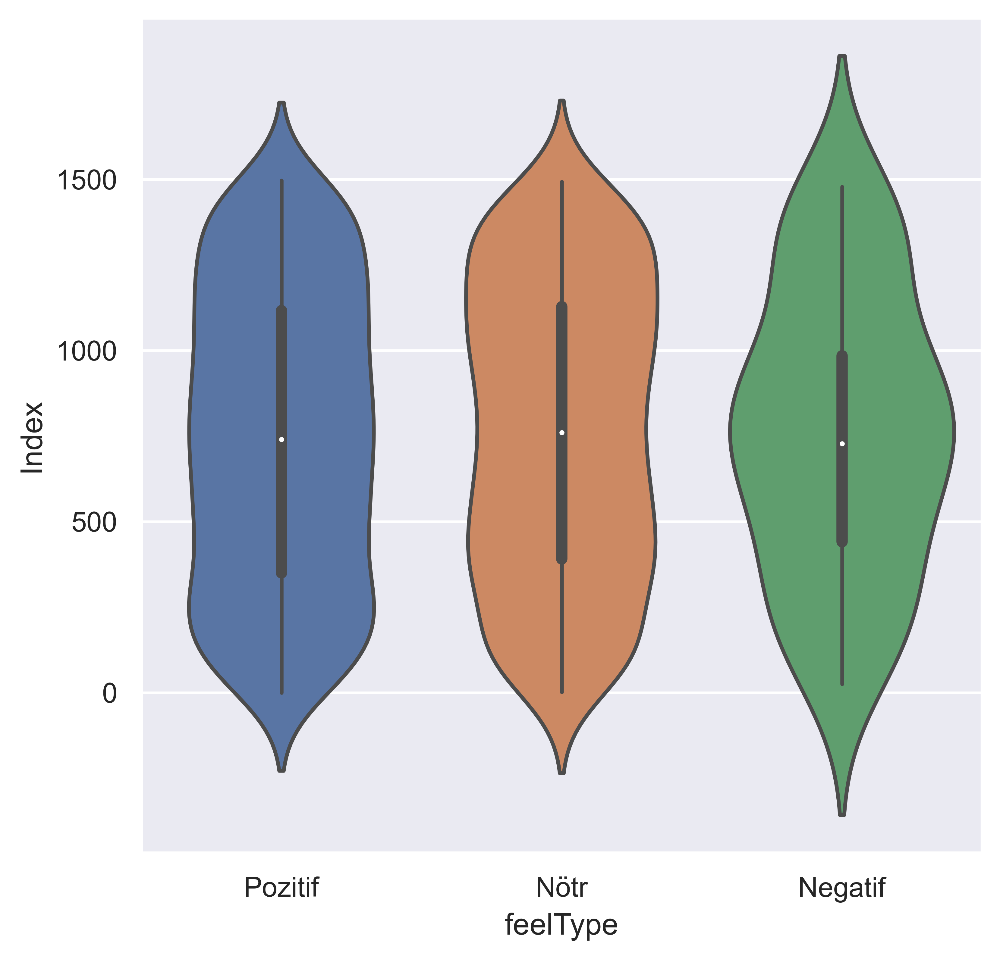

In [54]:
sns.violinplot(x="feelType",y="Index",data=englishSetNew)

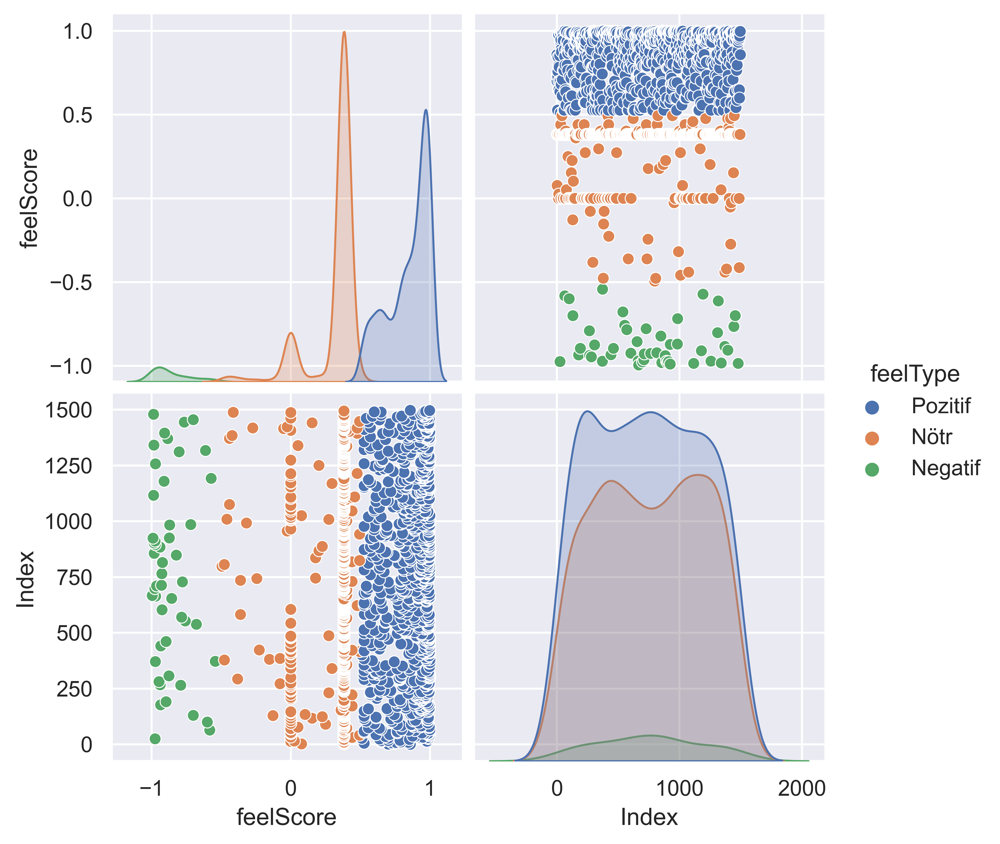

In [55]:
sns.pairplot(englishSetNew,hue="feelType",height=3)

**Cümleler ve duygu tiplerinin karşılıklı görüntüsü**

Türkçe ve İngilizce cümlelerin tutulduğu (Oluşturulan ilk DataFrame.) yapımıza yeni sütunlar ekledim.

In [56]:
df["DuyguTipi"]=turkishSet.DuyguTipi
df["FeelType"]=englishSet.feelType
df=pd.DataFrame(df,columns=["Turkish","DuyguTipi","English","FeelType"])

In [57]:
df.iloc[:50]

,Turkish,DuyguTipi,English,FeelType
0,Köy Öğretmenlik Becerileri Yerinde Deneyimlend...,Nötr,Village Teaching Skills Were Experienced on th...,Pozitif
1,"Ulusal Staj Programı Değerli Öğrencilerimiz,\n...",Nötr,"National Internship Program Dear Students,\nUn...",Pozitif
2,Termal Akışkan Sistemlerde Nanoparçacık Entegr...,Nötr,Nanoparticle Integration and Usage Challenges ...,Nötr
3,Hekimler İçin Almanca Hasta İletişimi ve Medik...,Nötr,German Patient Communication and Medical Germa...,Nötr
4,Elektronik İhale Genel Hükümler Eğitimi Değerl...,Nötr,Electronic Tender General Provisions Training ...,Pozitif
5,III. Uluslararası Müzik Araştırmaları Öğrenci ...,Nötr,III. International Music Research Student Cong...,Pozitif
6,Yabancı Dil Eğitim Kursları Değerli Mensupları...,Nötr,Foreign Language Training Courses Dear Members...,Nötr
7,Üniversitemiz Eğitim Fakültesi Düzce PEGEM Aka...,Nötr,Our University Faculty of Education Signed a C...,Pozitif
8,Düzce İnovasyon Platformu Kuruluyor Düzce Tekn...,Nötr,Düzce Innovation Platform is Being Established...,Pozitif
9,Mühendislik ve Doğa Bilimleri Dergisi Değerli ...,Nötr,Journal of Engineering and Natural Sciences De...,Pozitif
